# Advance Regression - Surprise Housing
## Objective :

*The Autralian company is looking to buy the house at lower value and then covert them to higer prices. We need to build a regression model using hosuing data with `Sale Price` as the `Target Variable` using the predictor variable and not diverting from the accuracy of the model. We also need to have the optimal value for ridge and lasso regression.*

*Business will get the idea of the prices and feature on which the price varries. Business can utilse these to meet the consumer demands and formulate the strategy againts the consumer behaviour to make it sellable and make profit.*

*The company wants to know:*
1. Which variables are significant in predicting the price of a house.
2. How well those variables describe the price of a house.

In [5]:
# Importing the libraries and ignoring the warnings
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels as sm
import statsmodels.api as sma
from statsmodels.stats.outliers_influence import variance_inflation_factor

import sklearn
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import r2_score
from sklearn.feature_selection import RFE
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import r2_score, mean_squared_error

import warnings
warnings.filterwarnings('ignore')

To reach our objective we will follow the below steps
 1. Reading the data, Understanding the data and Visualising the data.
 2. Prepare the data to create the model (EDA, re-scaling, train-test split etc)
 3. Use Ridge and Lasso Regression to train the model recursively. 
 4. Predit the model and Evaluate it on Test Set.

## Step 1: Reading the data, Understanding the data and Visualising the data

In [6]:
housing_data = pd.read_csv("/Users/sing73/upgrad/ACP/Housing Assignment/train.csv")
housing_data.info() # to get he info on the values
housing_data.head() # get the headers of the data set

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


#### There are few coloumn which have null values in majority (more than 90%) and some columns needs null handling in order to have right data set. We are using the data dictionary to understand the business and not removing the important columns.



In [7]:
housing_data = housing_data.drop(['Id','Alley','PoolQC','Fence','MiscFeature'], axis = 1)
housing_data.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,...,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,60,RL,65.0,8450,Pave,Reg,Lvl,AllPub,Inside,Gtl,...,0,0,0,0,0,2,2008,WD,Normal,208500
1,20,RL,80.0,9600,Pave,Reg,Lvl,AllPub,FR2,Gtl,...,0,0,0,0,0,5,2007,WD,Normal,181500
2,60,RL,68.0,11250,Pave,IR1,Lvl,AllPub,Inside,Gtl,...,0,0,0,0,0,9,2008,WD,Normal,223500
3,70,RL,60.0,9550,Pave,IR1,Lvl,AllPub,Corner,Gtl,...,272,0,0,0,0,2,2006,WD,Abnorml,140000
4,60,RL,84.0,14260,Pave,IR1,Lvl,AllPub,FR2,Gtl,...,0,0,0,0,0,12,2008,WD,Normal,250000


<Figure size 2880x3240 with 0 Axes>

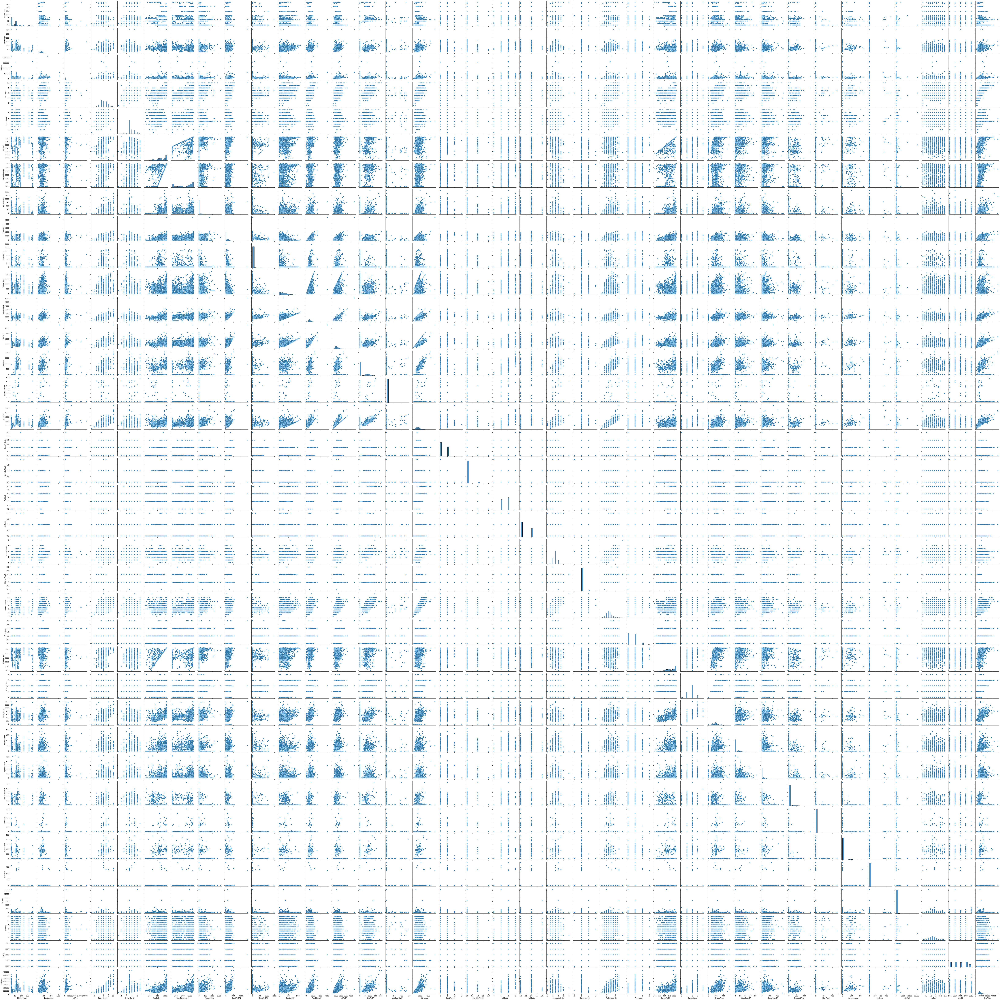

In [8]:
plt.figure(figsize = (40,45))
sns.pairplot(housing_data)
plt.show()

## Data Visulization

#### We will try to visulaize the data and form the relationship between the variable. We will try to do the pairplot for the data and box plot to check on the relationship with the target variables.

##### The pair plot is very difficult to understand as we can only zoom then to understand, we can drop the column with the less informantion / relevance. The below are such columns, these are 
1. LowQualFinSF
2. PoolArea
3. MiscVal
4. BsmtHalfBath
5. 3SsnPorch
6. FireplaceQu



Although the above pair plot is difficult to comprehend but by using a image editor to zoom in and view especially the diagonal values (histograms), we can see if any features have skewed information (for eg 98.3% values are 0 for `LowQualFinSF `). We can drop these columns as they carry little information.

Here are all such features - `LowQualFinSF, BsmtHalfBath, 3SsnPorch, PoolArea, MiscVal, FireplaceQu`

Deleting them now is better as these are categorical variables and will result in multiple features when we convert them to numerical features using one hot encoding.

##### We will double check by plotting these variables again before dropping them

<AxesSubplot:xlabel='MiscVal', ylabel='SalePrice'>

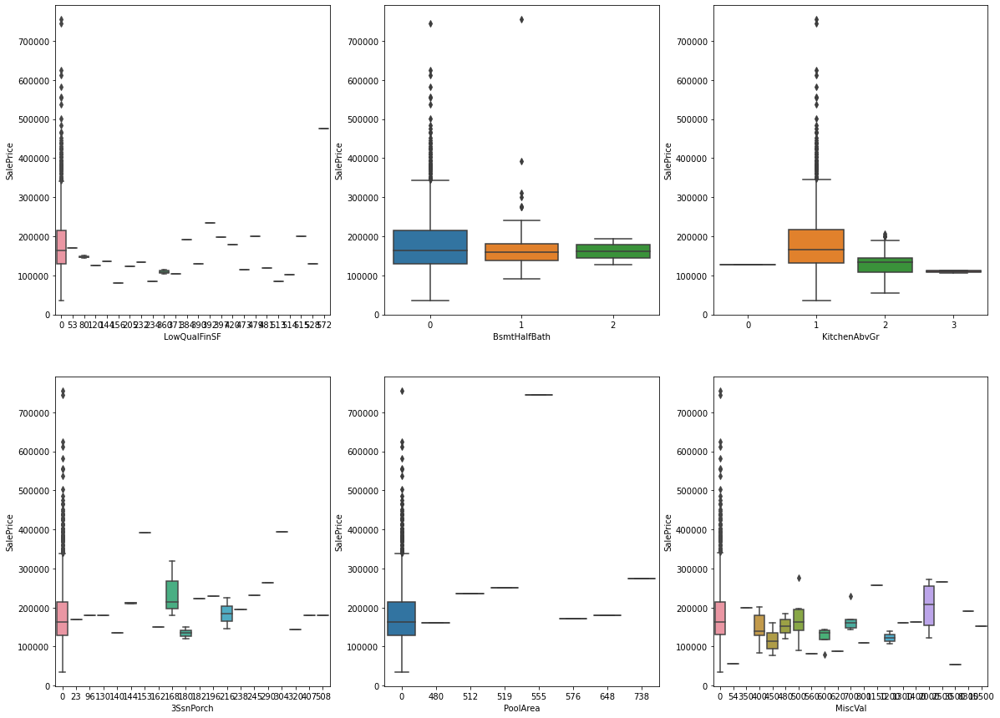

In [9]:
categ_vars = ['LowQualFinSF', 'BsmtHalfBath', '3SsnPorch', 'PoolArea', 'MiscVal']
plt.figure(figsize = (20,15))

plt.subplot(2,3,1)
sns.boxplot(x = 'LowQualFinSF', y = 'SalePrice', data = housing_data)

plt.subplot(2,3,2)
sns.boxplot(x = 'BsmtHalfBath', y = 'SalePrice', data = housing_data)

plt.subplot(2,3,3)
sns.boxplot(x = 'KitchenAbvGr', y = 'SalePrice', data = housing_data)

plt.subplot(2,3,4)
sns.boxplot(x = '3SsnPorch', y = 'SalePrice', data = housing_data)

plt.subplot(2,3,5)
sns.boxplot(x = 'PoolArea', y = 'SalePrice', data = housing_data)

plt.subplot(2,3,6)
sns.boxplot(x = 'MiscVal', y = 'SalePrice', data = housing_data)

<Figure size 1440x1800 with 0 Axes>

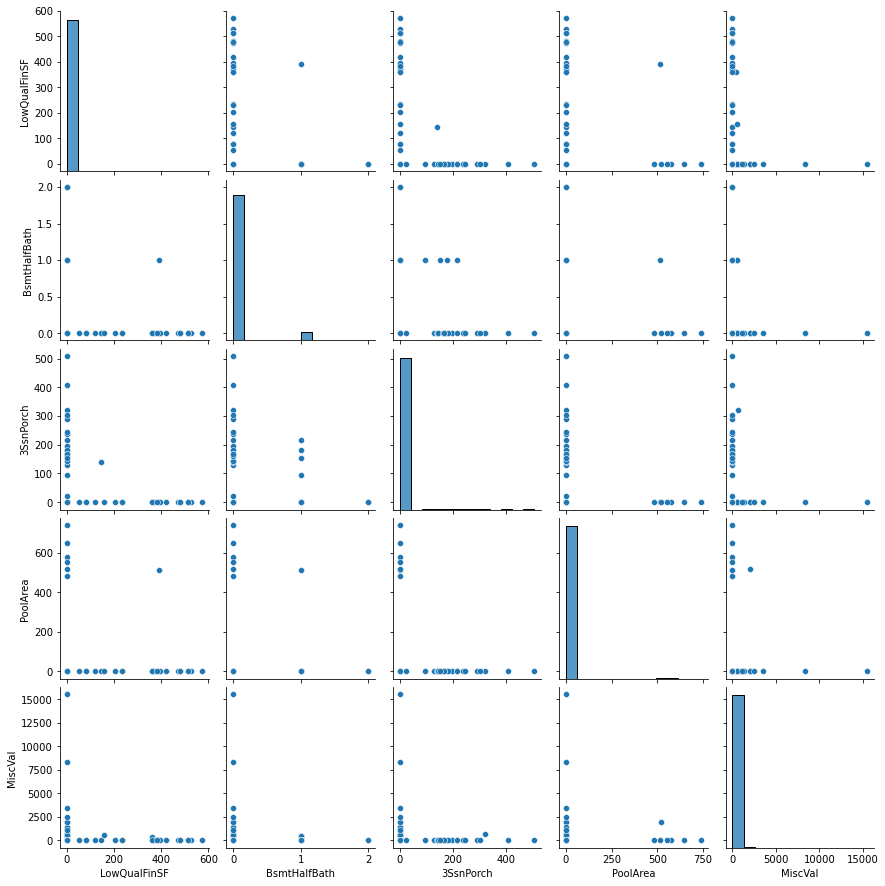

In [11]:
plt.figure(figsize = (20,25))
sns.pairplot(housing_data[categ_vars])
plt.show()

In [12]:
housing_data = housing_data.drop(['LowQualFinSF', 'BsmtHalfBath', '3SsnPorch', 'PoolArea', 'MiscVal', 'FireplaceQu'], axis = 1)

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,...,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,ScreenPorch,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,60,RL,65.0,8450,Pave,Reg,Lvl,AllPub,Inside,Gtl,...,Y,0,61,0,0,2,2008,WD,Normal,208500
1,20,RL,80.0,9600,Pave,Reg,Lvl,AllPub,FR2,Gtl,...,Y,298,0,0,0,5,2007,WD,Normal,181500
2,60,RL,68.0,11250,Pave,IR1,Lvl,AllPub,Inside,Gtl,...,Y,0,42,0,0,9,2008,WD,Normal,223500
3,70,RL,60.0,9550,Pave,IR1,Lvl,AllPub,Corner,Gtl,...,Y,0,35,272,0,2,2006,WD,Abnorml,140000
4,60,RL,84.0,14260,Pave,IR1,Lvl,AllPub,FR2,Gtl,...,Y,192,84,0,0,12,2008,WD,Normal,250000


In [13]:
housing_data.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,...,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,ScreenPorch,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,60,RL,65.0,8450,Pave,Reg,Lvl,AllPub,Inside,Gtl,...,Y,0,61,0,0,2,2008,WD,Normal,208500
1,20,RL,80.0,9600,Pave,Reg,Lvl,AllPub,FR2,Gtl,...,Y,298,0,0,0,5,2007,WD,Normal,181500
2,60,RL,68.0,11250,Pave,IR1,Lvl,AllPub,Inside,Gtl,...,Y,0,42,0,0,9,2008,WD,Normal,223500
3,70,RL,60.0,9550,Pave,IR1,Lvl,AllPub,Corner,Gtl,...,Y,0,35,272,0,2,2006,WD,Abnorml,140000
4,60,RL,84.0,14260,Pave,IR1,Lvl,AllPub,FR2,Gtl,...,Y,192,84,0,0,12,2008,WD,Normal,250000


## Step 2 - Prepare the data to create the model (EDA, re-scaling, train-test split etc)

In [14]:
## Method to convert all yes/no or true/false data to 0 and 1
def map_bool(x):
    return x.map({'Y': 1, 'N': 0})


housing_data['CentralAir'] = housing_data[['CentralAir']].apply(map_bool)

#### OverallQual and OverallCond are categorical columns and have numeric values so those are treated seperately
- Next we will covert categorical variables into numeric by using one hot encoding. 
- But before that we have to fix all the null values in categorical values by using mode

In [16]:
nulls = housing_data.isnull().sum().to_frame()
for index, row in nulls.iterrows():
    print(index, row[0])

MSSubClass 0
MSZoning 0
LotFrontage 259
LotArea 0
Street 0
LotShape 0
LandContour 0
Utilities 0
LotConfig 0
LandSlope 0
Neighborhood 0
Condition1 0
Condition2 0
BldgType 0
HouseStyle 0
OverallQual 0
OverallCond 0
YearBuilt 0
YearRemodAdd 0
RoofStyle 0
RoofMatl 0
Exterior1st 0
Exterior2nd 0
MasVnrType 8
MasVnrArea 8
ExterQual 0
ExterCond 0
Foundation 0
BsmtQual 37
BsmtCond 37
BsmtExposure 38
BsmtFinType1 37
BsmtFinSF1 0
BsmtFinType2 38
BsmtFinSF2 0
BsmtUnfSF 0
TotalBsmtSF 0
Heating 0
HeatingQC 0
CentralAir 0
Electrical 1
1stFlrSF 0
2ndFlrSF 0
GrLivArea 0
BsmtFullBath 0
FullBath 0
HalfBath 0
BedroomAbvGr 0
KitchenAbvGr 0
KitchenQual 0
TotRmsAbvGrd 0
Functional 0
Fireplaces 0
GarageType 81
GarageYrBlt 81
GarageFinish 81
GarageCars 0
GarageArea 0
GarageQual 81
GarageCond 81
PavedDrive 0
WoodDeckSF 0
OpenPorchSF 0
EnclosedPorch 0
ScreenPorch 0
MoSold 0
YrSold 0
SaleType 0
SaleCondition 0
SalePrice 0


In [17]:
# BsmtCond, BsmtExposure, BsmtFinType1, BsmtFinType2 and BsmtQual have a NA value for No Basement according to data dictionary 
# In the same way, GarageType, GarageYrBlt, GarageFinish, GarageQual and GarageCond have a NA value for No Garage in data dictionary 
# Since Python picked it as null value, no action required for null value handling
null_treatment_catg = ['MasVnrType', 'Electrical']

null_treatment_numer = ['LotFrontage','MasVnrArea']
for feature in null_treatment_catg:
    mode = housing_data[feature].mode()
    housing_data[feature] = housing_data[feature].fillna(mode)

for feature in null_treatment_numer:
    mean = housing_data[feature].mean()
    housing_data[feature] = housing_data[feature].fillna(mean)

In [19]:
housing_data.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,...,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,ScreenPorch,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,60,RL,65.0,8450,Pave,Reg,Lvl,AllPub,Inside,Gtl,...,Y,0,61,0,0,2,2008,WD,Normal,208500
1,20,RL,80.0,9600,Pave,Reg,Lvl,AllPub,FR2,Gtl,...,Y,298,0,0,0,5,2007,WD,Normal,181500
2,60,RL,68.0,11250,Pave,IR1,Lvl,AllPub,Inside,Gtl,...,Y,0,42,0,0,9,2008,WD,Normal,223500
3,70,RL,60.0,9550,Pave,IR1,Lvl,AllPub,Corner,Gtl,...,Y,0,35,272,0,2,2006,WD,Abnorml,140000
4,60,RL,84.0,14260,Pave,IR1,Lvl,AllPub,FR2,Gtl,...,Y,192,84,0,0,12,2008,WD,Normal,250000


In [20]:
# We have to subsitute 'NA' for proper values in basement and garage related fields

basement_features = ['BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'BsmtQual']
garage_features = ['GarageType', 'GarageFinish', 'GarageQual', 'GarageCond'] 
# GarageYrBlt is skipped as it will be converted to numeric variable later


for feature in basement_features:
    housing_data[feature] = housing_data[feature].astype(str).replace("nan","No_Basement")
    

for feature in garage_features:
    housing_data[feature] = housing_data[feature].astype(str).replace("nan","No_Garage")

In [21]:
housing_data['GarageType'].value_counts()

Attchd       870
Detchd       387
BuiltIn       88
No_Garage     81
Basment       19
CarPort        9
2Types         6
Name: GarageType, dtype: int64

In [22]:
# We should change GarageYrBlt to numeric type
housing_data['GarageYrBlt'] = housing_data['GarageYrBlt'].astype('float64')
housing_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 70 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   MSSubClass     1460 non-null   int64  
 1   MSZoning       1460 non-null   object 
 2   LotFrontage    1460 non-null   float64
 3   LotArea        1460 non-null   int64  
 4   Street         1460 non-null   object 
 5   LotShape       1460 non-null   object 
 6   LandContour    1460 non-null   object 
 7   Utilities      1460 non-null   object 
 8   LotConfig      1460 non-null   object 
 9   LandSlope      1460 non-null   object 
 10  Neighborhood   1460 non-null   object 
 11  Condition1     1460 non-null   object 
 12  Condition2     1460 non-null   object 
 13  BldgType       1460 non-null   object 
 14  HouseStyle     1460 non-null   object 
 15  OverallQual    1460 non-null   int64  
 16  OverallCond    1460 non-null   int64  
 17  YearBuilt      1460 non-null   int64  
 18  YearRemo

In [23]:
# all numeric (float and int) variables in the dataset
housing_numeric = housing_data.select_dtypes(include=['float64', 'int64'])
housing_numeric.describe()

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,...,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,ScreenPorch,MoSold,YrSold,SalePrice
count,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,...,1379.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,46.549315,...,1978.506164,1.767123,472.980137,94.244521,46.660274,21.954110,15.060959,6.321918,2007.815753,180921.195890
std,42.300571,22.024023,9981.264932,1.382997,1.112799,30.202904,20.645407,180.569112,456.098091,161.319273,...,24.689725,0.747315,213.804841,125.338794,66.256028,61.119149,55.757415,2.703626,1.328095,79442.502883
min,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,0.000000,...,1900.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,20.000000,60.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,0.000000,...,1961.000000,1.000000,334.500000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,50.000000,70.049958,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,0.000000,...,1980.000000,2.000000,480.000000,0.000000,25.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,70.000000,79.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,164.250000,712.250000,0.000000,...,2002.000000,2.000000,576.000000,168.000000,68.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,1474.000000,...,2010.000000,4.000000,1418.000000,857.000000,547.000000,552.000000,480.000000,12.000000,2010.000000,755000.000000


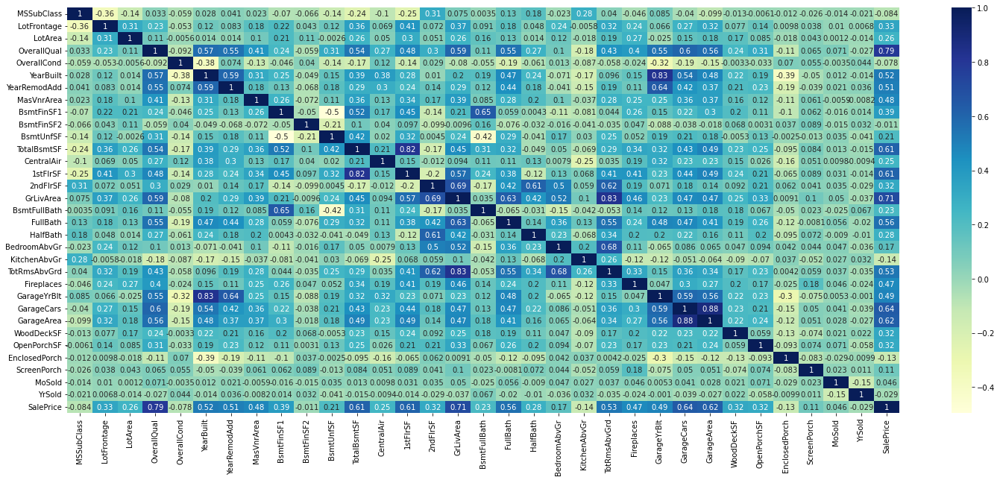

In [25]:
# Plotting Heatmap corelations 

cor = housing_numeric.corr()
cor
# figure size
plt.figure(figsize=(25,10))

# heatmap
sns.heatmap(cor, cmap="YlGnBu", annot=True)
plt.show()

##### The corelation metrix helped in finding the relation on below attributes
- TotalBsmtSF & 1stFlrSF
- GrLivArea & TotRmsAbvGrd

We can dropn the TotalBsmtSF and TotRmsAbvGrd

In [26]:
housing_data = housing_data.drop(['TotalBsmtSF', 'TotRmsAbvGrd'], axis = 1)

In [27]:
housing_data.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,...,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,ScreenPorch,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,60,RL,65.0,8450,Pave,Reg,Lvl,AllPub,Inside,Gtl,...,Y,0,61,0,0,2,2008,WD,Normal,208500
1,20,RL,80.0,9600,Pave,Reg,Lvl,AllPub,FR2,Gtl,...,Y,298,0,0,0,5,2007,WD,Normal,181500
2,60,RL,68.0,11250,Pave,IR1,Lvl,AllPub,Inside,Gtl,...,Y,0,42,0,0,9,2008,WD,Normal,223500
3,70,RL,60.0,9550,Pave,IR1,Lvl,AllPub,Corner,Gtl,...,Y,0,35,272,0,2,2006,WD,Abnorml,140000
4,60,RL,84.0,14260,Pave,IR1,Lvl,AllPub,FR2,Gtl,...,Y,192,84,0,0,12,2008,WD,Normal,250000


In [28]:
# dummy categorical variables creation

# subset all categorical variables
housing_categorical = housing_data.select_dtypes(include=['object'])


,MSZoning,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,...,Electrical,KitchenQual,Functional,GarageType,GarageFinish,GarageQual,GarageCond,PavedDrive,SaleType,SaleCondition
0,RL,Pave,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,...,SBrkr,Gd,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
1,RL,Pave,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,...,SBrkr,TA,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
2,RL,Pave,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,...,SBrkr,Gd,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
3,RL,Pave,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,...,SBrkr,Gd,Typ,Detchd,Unf,TA,TA,Y,WD,Abnorml
4,RL,Pave,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,...,SBrkr,Gd,Typ,Attchd,RFn,TA,TA,Y,WD,Normal


In [29]:
housing_categorical.head()

,MSZoning,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,...,Electrical,KitchenQual,Functional,GarageType,GarageFinish,GarageQual,GarageCond,PavedDrive,SaleType,SaleCondition
0,RL,Pave,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,...,SBrkr,Gd,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
1,RL,Pave,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,...,SBrkr,TA,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
2,RL,Pave,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,...,SBrkr,Gd,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
3,RL,Pave,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,...,SBrkr,Gd,Typ,Detchd,Unf,TA,TA,Y,WD,Abnorml
4,RL,Pave,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,...,SBrkr,Gd,Typ,Attchd,RFn,TA,TA,Y,WD,Normal


In [30]:
housing_categorical.columns

Index(['MSZoning', 'Street', 'LotShape', 'LandContour', 'Utilities',
       'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2',
       'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st',
       'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation',
       'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2',
       'Heating', 'HeatingQC', 'Electrical', 'KitchenQual', 'Functional',
       'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond', 'PavedDrive',
       'SaleType', 'SaleCondition'],
      dtype='object')

In [31]:
#### We are ready for one hot encoding for categorical variables having more than 2 values
# convert into dummies - one hot encoding
housing_dummies = pd.get_dummies(housing_categorical, drop_first=True)
housing_dummies.head()


,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Pave,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,...,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
0,0,0,1,0,1,0,0,1,0,0,...,0,0,0,0,1,0,0,0,1,0
1,0,0,1,0,1,0,0,1,0,0,...,0,0,0,0,1,0,0,0,1,0
2,0,0,1,0,1,0,0,0,0,0,...,0,0,0,0,1,0,0,0,1,0
3,0,0,1,0,1,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
4,0,0,1,0,1,0,0,0,0,0,...,0,0,0,0,1,0,0,0,1,0


In [32]:
# drop categorical variables from the housing data frame
X = housing_data.drop(list(housing_categorical.columns), axis=1)

In [33]:
# concat dummy variables with X
X = pd.concat([X, housing_dummies], axis=1)
X.head()

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,...,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
0,60,65.0,8450,7,5,2003,2003,196.0,706,0,...,0,0,0,0,1,0,0,0,1,0
1,20,80.0,9600,6,8,1976,1976,0.0,978,0,...,0,0,0,0,1,0,0,0,1,0
2,60,68.0,11250,7,5,2001,2002,162.0,486,0,...,0,0,0,0,1,0,0,0,1,0
3,70,60.0,9550,7,5,1915,1970,0.0,216,0,...,0,0,0,0,1,0,0,0,0,0
4,60,84.0,14260,8,5,2000,2000,350.0,655,0,...,0,0,0,0,1,0,0,0,1,0


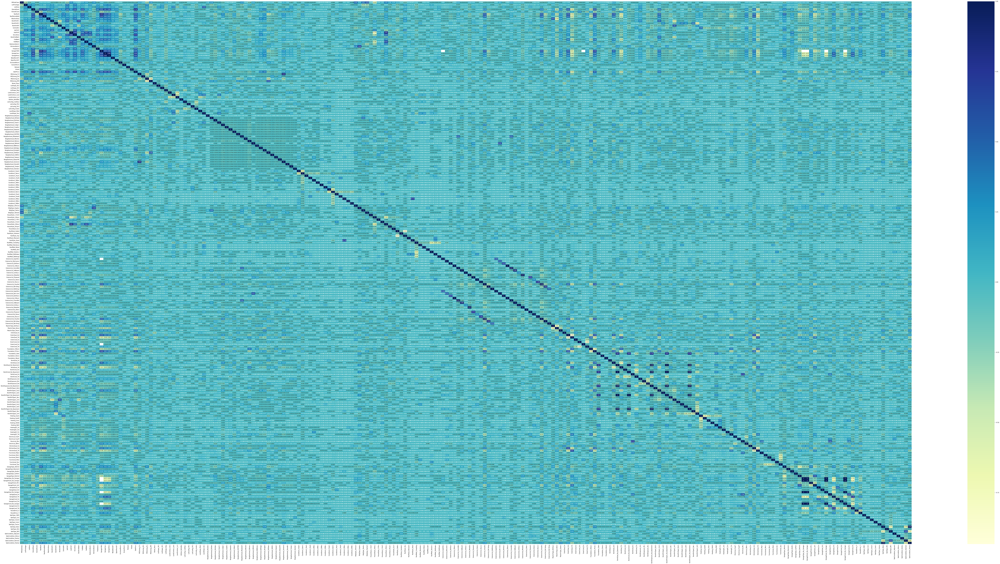

In [34]:
# plotting correlations on a heatmap

# correlation matrix
cor1 = X.corr()

# figure size
plt.figure(figsize=(160,80))

# heatmap
sns.heatmap(cor1, cmap="YlGnBu", annot=True)
plt.show()

From the correlation matrix we find the following attributes related closey
- Yearbuilt & 1stFlrSF
- GarageYrBlt 
- Neighborhood_Somerst and MSZoning_FV .86
- BsmtQual_No_basement and BsmtCond_No_basement
- BsmtQual_No_basement and BsmtExposure_GD
- GarageType_No_garage and GarageCond_Po 1
- GarageFinish_No_garage and GarageCond_Po 1
- GarageQual_No_garage and GarageCond_Po 1
- GarageFinish_Rfn and GarageType_No_garage
- GarageFinish_Rfn and GarageFinish_No_garage
- SaleType_New and SaleCondition_Partial .99
- 2ndFlrSF and HouseStyle_2Story .81 

So, we will drop some of these based on current domain knowledge

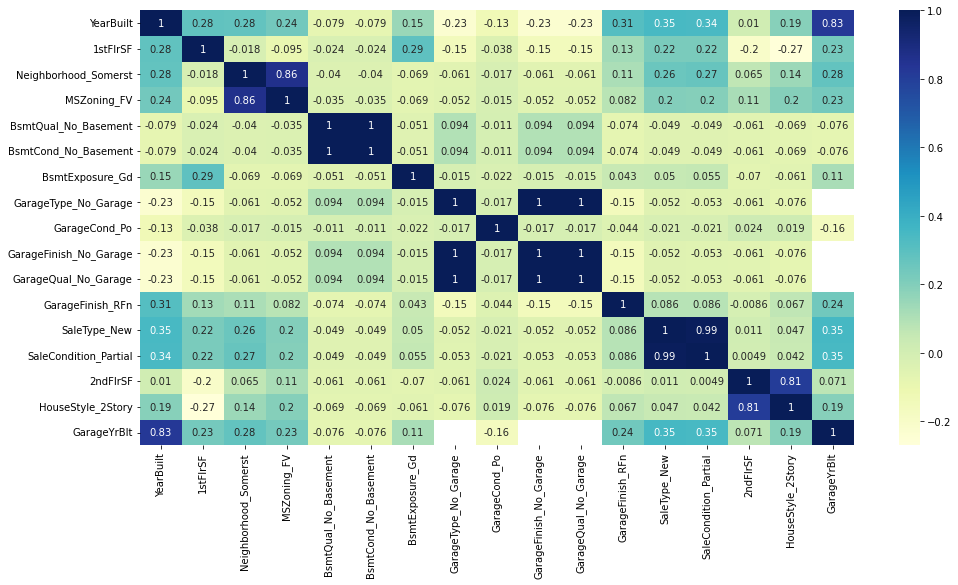

In [35]:
# Plotting heatmap before dropping them

# correlation matrix
subset = ['YearBuilt', '1stFlrSF', 'Neighborhood_Somerst', 'MSZoning_FV', 'BsmtQual_No_Basement',
            'BsmtCond_No_Basement','BsmtExposure_Gd','GarageType_No_Garage','GarageCond_Po','GarageFinish_No_Garage',
        'GarageQual_No_Garage','GarageFinish_RFn','SaleType_New','SaleCondition_Partial','2ndFlrSF',
        'HouseStyle_2Story','GarageYrBlt']

cor2 = X[subset].corr()

# figure size
plt.figure(figsize=(16,8))

# heatmap
sns.heatmap(cor2, cmap="YlGnBu", annot=True)
plt.show()

In [36]:
#Dropping few more columns
X = X.drop(['GarageCond_Po','GarageYrBlt','GarageFinish_No_Garage','GarageType_No_Garage','MSZoning_FV',
           'BsmtQual_No_Basement','SaleCondition_Partial','HouseStyle_2Story'], axis=1)

In [37]:
X.head()

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,...,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal
0,60,65.0,8450,7,5,2003,2003,196.0,706,0,...,0,0,0,0,0,1,0,0,0,1
1,20,80.0,9600,6,8,1976,1976,0.0,978,0,...,0,0,0,0,0,1,0,0,0,1
2,60,68.0,11250,7,5,2001,2002,162.0,486,0,...,0,0,0,0,0,1,0,0,0,1
3,70,60.0,9550,7,5,1915,1970,0.0,216,0,...,0,0,0,0,0,1,0,0,0,0
4,60,84.0,14260,8,5,2000,2000,350.0,655,0,...,0,0,0,0,0,1,0,0,0,1


In [ ]:
# let's see one row to verify everything looks good before we start modelling process
X.loc[1,:]

## Step 3 - Model Building 
- Splitting the data between the Train and Test

In [38]:
df_train, df_test = train_test_split(X, train_size=0.7, random_state=100)
print(df_train.shape)
print(df_test.shape)

(1021, 227)
(439, 227)


In [40]:
housing_numeric.columns

Index(['MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual', 'OverallCond',
       'YearBuilt', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2',
       'BsmtUnfSF', 'TotalBsmtSF', 'CentralAir', '1stFlrSF', '2ndFlrSF',
       'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath', 'BedroomAbvGr',
       'KitchenAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'GarageYrBlt',
       'GarageCars', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF',
       'EnclosedPorch', 'ScreenPorch', 'MoSold', 'YrSold', 'SalePrice'],
      dtype='object')

In [41]:
scaler = MinMaxScaler()
#create a list of numeric variables

num_vars = ['MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual', 'OverallCond',
       'YearBuilt', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2',
       'BsmtUnfSF', 'CentralAir', '1stFlrSF', '2ndFlrSF',
       'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath', 'BedroomAbvGr',
       'KitchenAbvGr', 'Fireplaces',
       'GarageCars', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF',
       'EnclosedPorch', 'ScreenPorch', 'MoSold', 'YrSold', 'SalePrice']

df_train[num_vars] = scaler.fit_transform(df_train[num_vars])
df_test[num_vars] = scaler.transform(df_test[num_vars])

df_train.head()

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,...,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal
318,0.235294,0.236301,0.039403,0.666667,0.500,0.876812,0.716667,0.16,0.174876,0.000000,...,0,0,0,0,0,1,0,0,0,1
239,0.176471,0.106164,0.033981,0.555556,0.375,0.528986,0.000000,0.00,0.016655,0.000000,...,0,0,0,0,0,1,0,0,0,1
986,0.176471,0.130137,0.017931,0.555556,0.875,0.275362,0.883333,0.00,0.000000,0.000000,...,0,0,0,0,0,1,0,0,0,1
1416,1.000000,0.133562,0.046139,0.333333,0.625,0.094203,0.000000,0.00,0.000000,0.000000,...,0,0,0,0,0,1,0,0,0,1
390,0.176471,0.099315,0.032409,0.444444,0.875,0.202899,0.000000,0.00,0.042700,0.265265,...,0,0,0,0,0,1,0,0,0,1


In [42]:
df_train.describe()

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,...,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal
count,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,...,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000
mean,0.226306,0.166956,0.042162,0.565894,0.572600,0.719719,0.583072,0.065560,0.079406,0.033980,...,0.004897,0.002938,0.003918,0.078355,0.002938,0.870715,0.002938,0.007835,0.013712,0.825661
std,0.254701,0.075649,0.048221,0.155515,0.136515,0.219718,0.343416,0.117016,0.082409,0.115907,...,0.069842,0.054153,0.062500,0.268860,0.054153,0.335680,0.054153,0.088214,0.116350,0.379587
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.133562,0.027937,0.444444,0.500000,0.594203,0.283333,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
50%,0.176471,0.167979,0.037555,0.555556,0.500000,0.731884,0.733333,0.000000,0.069454,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
75%,0.294118,0.195205,0.046943,0.666667,0.625000,0.927536,0.900000,0.098750,0.126152,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [43]:
df_test.describe()

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,...,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal
count,439.000000,439.000000,439.000000,439.000000,439.00000,439.000000,439.000000,439.000000,439.000000,439.000000,...,439.000000,439.000000,439.000000,439.000000,439.0,439.000000,439.000000,439.000000,439.000000,439.000000
mean,0.195498,0.170360,0.042580,0.568211,0.57033,0.718431,0.576500,0.063043,0.076739,0.025998,...,0.009112,0.004556,0.002278,0.095672,0.0,0.861048,0.002278,0.009112,0.013667,0.808656
std,0.233458,0.074933,0.042978,0.149440,0.14508,0.217104,0.346002,0.102634,0.077027,0.092564,...,0.095127,0.067420,0.047727,0.294476,0.0,0.346291,0.047727,0.095127,0.116239,0.393808
min,0.000000,0.000000,-0.000828,0.000000,0.12500,0.021739,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.133562,0.029293,0.444444,0.50000,0.594203,0.266667,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.0,1.000000,0.000000,0.000000,0.000000,1.000000
50%,0.176471,0.167979,0.036947,0.555556,0.50000,0.724638,0.716667,0.000000,0.063962,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.0,1.000000,0.000000,0.000000,0.000000,1.000000
75%,0.235294,0.202055,0.047823,0.666667,0.62500,0.934783,0.900000,0.108750,0.125177,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.0,1.000000,0.000000,0.000000,0.000000,1.000000
max,1.000000,1.000000,0.736888,1.000000,1.00000,0.992754,1.000000,0.575625,0.387668,0.764586,...,1.000000,1.000000,1.000000,1.000000,0.0,1.000000,1.000000,1.000000,1.000000,1.000000


In [44]:
# divide the training data frame into dependent and independent variables
y_train = df_train.pop('SalePrice')
X_train = df_train

In [45]:
# divide the test data frame into dependent and independent variables
y_test = df_test.pop('SalePrice')
X_test = df_test

In [46]:
# Instantiate
lm = LinearRegression()

# Fit a line
lm.fit(X_train, y_train)

LinearRegression()

In [47]:
# calculation r2, mse and rmse on train and test using liner model
y_pred_train = lm.predict(X_train)
y_pred_test = lm.predict(X_test)

metric = []
r2_train_lr = r2_score(y_train, y_pred_train)
print(r2_train_lr)
metric.append(r2_train_lr)

r2_test_lr = r2_score(y_test, y_pred_test)
print(r2_test_lr)
metric.append(r2_test_lr)

rss1_lr = np.sum(np.square(y_train - y_pred_train))
print(rss1_lr)
metric.append(rss1_lr)

rss2_lr = np.sum(np.square(y_test - y_pred_test))
print(rss2_lr)
metric.append(rss2_lr)

mse_train_lr = mean_squared_error(y_train, y_pred_train)
print(mse_train_lr)
metric.append(mse_train_lr**0.5)

mse_test_lr = mean_squared_error(y_test, y_pred_test)
print(mse_test_lr)
metric.append(mse_test_lr**0.5)

0.9472826772317969
-4.134031171461433e+20
0.6488058537997616
2.252776155206685e+21
0.000635461169245604
5.131608554001561e+18


#### We see the case of overfittting, as r2 score on test is negative hence we will use regularization to fix this issue
### Ridge and Lasso Regression
### Ridge Regression

In [48]:
# list of alphas to tune - if value too high it will lead to underfitting, if it is too low, 
# it will not handle the overfitting
params = {'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 
 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0, 
 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50, 100, 500, 1000 ]}

ridge = Ridge()

# cross validation
folds = 5
model_cv = GridSearchCV(estimator = ridge, 
                        param_grid = params, 
                        scoring= 'neg_mean_absolute_error',  
                        cv = folds, 
                        return_train_score=True,
                        verbose = 1)            
model_cv.fit(X_train, y_train)

Fitting 5 folds for each of 28 candidates, totalling 140 fits


GridSearchCV(cv=5, estimator=Ridge(),
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3,
                                   0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0,
                                   4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50,
                                   100, 500, 1000]},
             return_train_score=True, scoring='neg_mean_absolute_error',
             verbose=1)

In [49]:
# Printing the best hyperparameter alpha
print(model_cv.best_params_)

{'alpha': 5.0}


In [50]:
#Fitting Ridge model for alpha = 5 and printing coefficients which have been penalised
alpha = 5
ridge = Ridge(alpha=alpha)

ridge.fit(X_train, y_train)
print(ridge.coef_)

[-2.91986683e-02 -2.84257774e-03  2.78442653e-02  8.59551219e-02
  3.06427587e-02  4.86305652e-03  1.43887271e-02  3.25572008e-02
  2.26298644e-02  1.17935213e-02  2.94437453e-02  8.90905212e-03
  6.72469560e-02  7.60623084e-02  8.55755516e-02  3.06267732e-02
  4.49150313e-02  1.10729084e-02  1.50936200e-02 -1.09641487e-02
  2.83960851e-02  4.40697685e-02  2.49892960e-02  1.95876109e-02
  1.76797004e-03  3.69292183e-04  7.73506102e-03 -2.63259533e-03
 -5.01687000e-03  8.48552141e-03  1.04754394e-02  5.39377130e-03
  5.97303355e-03  3.42942305e-03 -1.63920857e-02  2.53883107e-04
  1.83907880e-02  1.72273588e-02  2.05429736e-02 -7.52413846e-03
  1.49695638e-02 -1.62786687e-02 -6.32086837e-03 -2.96421876e-03
  7.51518193e-03  6.57298128e-03 -3.26504340e-03 -4.05409292e-03
 -4.87467114e-03  1.47618112e-03 -9.77345559e-03  3.02490697e-02
 -2.80084835e-02 -1.44719030e-02 -1.44141809e-02 -1.01256293e-02
 -2.26948260e-02 -1.50089291e-02 -8.42838050e-04 -7.29435519e-03
  6.27890308e-02  3.59571

In [51]:
# Lets calculate some metrics such as R2 score, RSS and RMSE
y_pred_train = ridge.predict(X_train)
y_pred_test = ridge.predict(X_test)

metric2 = []
r2_train_lr = r2_score(y_train, y_pred_train)
print(r2_train_lr)
metric2.append(r2_train_lr)

r2_test_lr = r2_score(y_test, y_pred_test)
print(r2_test_lr)
metric2.append(r2_test_lr)

rss1_lr = np.sum(np.square(y_train - y_pred_train))
print(rss1_lr)
metric2.append(rss1_lr)

rss2_lr = np.sum(np.square(y_test - y_pred_test))
print(rss2_lr)
metric2.append(rss2_lr)

mse_train_lr = mean_squared_error(y_train, y_pred_train)
print(mse_train_lr)
metric2.append(mse_train_lr**0.5)

mse_test_lr = mean_squared_error(y_test, y_pred_test)
print(mse_test_lr)
metric2.append(mse_test_lr**0.5)

0.8924078937318097
0.8638246709898662
1.324164140056677
0.74206633041184
0.0012969286386451293
0.0016903561057217311


### r2 score on train and test is now very close, so Ridge regression has solved overfitting for us.

## Lasso

In [52]:
# list of alphas to tune for lasso - if value too high it will lead to underfitting, if it is too low, 
# it will not handle the overfitting

lasso = Lasso()

# cross validation
folds = 5
model_cv1 = GridSearchCV(estimator = lasso, 
                        param_grid = params, 
                        scoring= 'neg_mean_absolute_error',  
                        cv = folds, 
                        return_train_score=True,
                        verbose = 1)            
model_cv1.fit(X_train, y_train)

Fitting 5 folds for each of 28 candidates, totalling 140 fits


GridSearchCV(cv=5, estimator=Lasso(),
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3,
                                   0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0,
                                   4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50,
                                   100, 500, 1000]},
             return_train_score=True, scoring='neg_mean_absolute_error',
             verbose=1)

In [53]:
# Printing the best hyperparameter alpha
print(model_cv1.best_params_)

{'alpha': 0.0001}


#### Lasso has selected a very low value of lambda. Let's see the train and test score on Lasso

In [54]:
#Fitting Lasso model for alpha = 0.0001 and printing coefficients which have been penalised

alpha = 0.0001

lasso = Lasso(alpha=alpha)
        
lasso.fit(X_train, y_train) 

Lasso(alpha=0.0001)

In [55]:
# Lets calculate some metrics such as R2 score, RSS and RMSE for Lasso

y_pred_train = lasso.predict(X_train)
y_pred_test = lasso.predict(X_test)

metric3 = []
r2_train_lr = r2_score(y_train, y_pred_train)
print(r2_train_lr)
metric3.append(r2_train_lr)

r2_test_lr = r2_score(y_test, y_pred_test)
print(r2_test_lr)
metric3.append(r2_test_lr)

rss1_lr = np.sum(np.square(y_train - y_pred_train))
print(rss1_lr)
metric3.append(rss1_lr)

rss2_lr = np.sum(np.square(y_test - y_pred_test))
print(rss2_lr)
metric3.append(rss2_lr)

mse_train_lr = mean_squared_error(y_train, y_pred_train)
print(mse_train_lr)
metric3.append(mse_train_lr**0.5)

mse_test_lr = mean_squared_error(y_test, y_pred_test)
print(mse_test_lr)
metric3.append(mse_test_lr**0.5)

0.9045423143727254
0.8574750980098249
1.1748226573923988
0.77666734335032
0.0011506588221277167
0.0017691739028481092


In [56]:
# Creating a table which contain all the metrics

lr_table = {'Metric': ['R2 Score (Train)','R2 Score (Test)','RSS (Train)','RSS (Test)',
                       'MSE (Train)','MSE (Test)'], 
        'Linear Regression': metric
        }

lr_metric = pd.DataFrame(lr_table ,columns = ['Metric', 'Linear Regression'] )

rg_metric = pd.Series(metric2, name = 'Ridge Regression')
ls_metric = pd.Series(metric3, name = 'Lasso Regression')

final_metric = pd.concat([lr_metric, rg_metric, ls_metric], axis = 1)

final_metric

,Metric,Linear Regression,Ridge Regression,Lasso Regression
0,R2 Score (Train),9.472827e-01,0.892408,0.904542
1,R2 Score (Test),-4.134031e+20,0.863825,0.857475
2,RSS (Train),6.488059e-01,1.324164,1.174823
3,RSS (Test),2.252776e+21,0.742066,0.776667
4,MSE (Train),2.520836e-02,0.036013,0.033921
5,MSE (Test),2.265305e+09,0.041114,0.042062


### Ridge and Lasso Regression both have solved the problem of overfitting and this can be inferred.
Choosing the Lasso Regression over the Ridge is because it removes some feature which are not much requried by the Business. Both Ridge and Lasso is similar so we choose the benefit of feature elimination.

### Solution for Subjective Questions

In [57]:
# Count as how many features Lasso is considering and sort them according to significance

lasso_scores = pd.DataFrame(
{
    "Feature": X_train.columns,
    "Coeff": lasso.coef_
})

In [58]:
#Filter out features for which coeff is 0

lasso_scores = lasso_scores[lasso_scores["Coeff"]!=0]
lasso_scores.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 119 entries, 0 to 225
Data columns (total 2 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   Feature  119 non-null    object 
 1   Coeff    119 non-null    float64
dtypes: float64(1), object(1)
memory usage: 2.8+ KB


In [59]:
lasso_scores.sort_values(by="Coeff", ascending = False)

,Feature,Coeff
14,GrLivArea,0.338970
106,RoofMatl_WdShngl,0.123036
3,OverallQual,0.120857
60,Neighborhood_NoRidge,0.065602
21,GarageCars,0.053796
...,...,...
0,MSSubClass,-0.035662
152,BsmtQual_Gd,-0.037945
188,KitchenQual_Gd,-0.039320
189,KitchenQual_TA,-0.039331


#### Lasso has kept on 119 feature out of 227 and eliminated 108 feature. 

In [60]:
# We are solving the question where we use 2 times the value of lambda suggested by Ridge and Lasso

# Fitting Ridge model for alpha = 10 and printing coefficients 
alpha = 10
ridge = Ridge(alpha=alpha)

ridge.fit(X_train, y_train)

Ridge(alpha=10)

In [61]:
# We will calculate some metrics such as R2 score, RSS and RMSE when lambda=10
y_pred_train = ridge.predict(X_train)
y_pred_test = ridge.predict(X_test)

metric2 = []
r2_train_lr = r2_score(y_train, y_pred_train)
print("r2 on train set after doubling lambda for Ridge")
print(r2_train_lr)


r2_test_lr = r2_score(y_test, y_pred_test)
print("r2 on test set after doubling lambda for Ridge")
print(r2_test_lr)

r2 on train set after doubling lambda for Ridge
0.8803333691040196
r2 on test set after doubling lambda for Ridge
0.8575229794032266


In [62]:
#Fit the Lasso model for alpha = 0.0002

alpha = 0.0002

lasso = Lasso(alpha=alpha)
        
lasso.fit(X_train, y_train) 

Lasso(alpha=0.0002)

In [63]:
y_pred_train = lasso.predict(X_train)
y_pred_test = lasso.predict(X_test)


r2_train_lr = r2_score(y_train, y_pred_train)
print("r2 on train set after doubling lambda for Lasso")
print(r2_train_lr)


r2_test_lr = r2_score(y_test, y_pred_test)
print("r2 on test set after doubling lambda for Lasso")
print(r2_test_lr)

r2 on train set after doubling lambda for Lasso
0.8911979763993433
r2 on test set after doubling lambda for Lasso
0.8608921127366799


In [65]:
# We will count the Lasso Feature and sort them as per their proirity / significance.
lasso_scores = pd.DataFrame(
{
    "Feature": X_train.columns,
    "Coeff": lasso.coef_
})

In [66]:
# Coeff with 0 is filtered out

lasso_scores = lasso_scores[lasso_scores["Coeff"]!=0]
lasso_scores.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 86 entries, 0 to 225
Data columns (total 2 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   Feature  86 non-null     object 
 1   Coeff    86 non-null     float64
dtypes: float64(1), object(1)
memory usage: 2.0+ KB


In [67]:
lasso_scores.sort_values(by="Coeff", ascending = False)

,Feature,Coeff
14,GrLivArea,0.311167
3,OverallQual,0.133995
106,RoofMatl_WdShngl,0.082127
60,Neighborhood_NoRidge,0.068543
21,GarageCars,0.054936
...,...,...
152,BsmtQual_Gd,-0.033931
188,KitchenQual_Gd,-0.036234
189,KitchenQual_TA,-0.037233
0,MSSubClass,-0.039084


In [68]:
## Remove 5 most significant feature by Lasso and train with next set of 5 features

X_train = df_train.drop(["GrLivArea","RoofMatl_WdShngl", "OverallQual", "Neighborhood_NoRidge", "GarageCars"], axis = 1)
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1021 entries, 318 to 792
Columns: 221 entries, MSSubClass to SaleCondition_Normal
dtypes: float64(26), uint8(195)
memory usage: 409.8 KB


In [69]:
X_test = df_test.drop(["GrLivArea","RoofMatl_WdShngl", "OverallQual", "Neighborhood_NoRidge", "GarageCars"], axis = 1)
X_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 439 entries, 1436 to 210
Columns: 221 entries, MSSubClass to SaleCondition_Normal
dtypes: float64(26), uint8(195)
memory usage: 176.2 KB


In [70]:
#Fitting Lasso model for alpha = 0.0001 and printing penalised coefficients 


lasso = Lasso(alpha=0.0001)
        
lasso.fit(X_train, y_train) 

Lasso(alpha=0.0001)

In [71]:
# recalculating the next set of top 5 features from Lasso

lasso_scores = pd.DataFrame(
{
    "Feature": X_train.columns,
    "Coeff": lasso.coef_
})

lasso_scores = lasso_scores[lasso_scores["Coeff"]!=0]

lasso_scores.sort_values(by="Coeff", ascending = False)

,Feature,Coeff
11,1stFlrSF,0.331983
12,2ndFlrSF,0.196507
6,MasVnrArea,0.059019
2,LotArea,0.055674
19,GarageArea,0.049545
...,...,...
147,BsmtQual_Gd,-0.041507
148,BsmtQual_TA,-0.041929
183,KitchenQual_Gd,-0.044259
184,KitchenQual_TA,-0.045322
